# Описание
Простейший пример ООП в Python, в которой присутствует интересная формула вычисления позиции точек на окне, которая рисовала некое подобие **водоворота**
$$\Huge
\begin{array}{l}
x\to x+\cos{\left(y\cdot\frac{\pi}{180}\right)};\\
y\to y+\sin{\left(x\cdot\frac{\pi}{180}\right)}.\\
\end{array}
$$

$$\Huge
\begin{array}{l}
x\to x+\cos{\left(y\cdot\frac{\pi}{180}\right)}+\dfrac{\cos{\left(3y\cdot\frac{\pi}{180}\right)}}{2};\\
y\to y+\sin{\left(x\cdot\frac{\pi}{180}\right)}+\dfrac{\sin{\left(3x\cdot\frac{\pi}{180}\right)}}{2};\\
\end{array}
$$

$$\Huge
\begin{array}{l}
x\to x+\cos{\left(y\cdot\frac{\pi}{180}\right)}+0.6;\\
y\to y+\sin{\left(x\cdot\frac{\pi}{180}\right)}.\\
x\to 0, x>\text{width}
\end{array}
$$

In [3]:
import pygame as pg
from random import randint as rd
from math import sin, cos, radians, floor
import matplotlib.pyplot as plt

pygame 2.6.1 (SDL 2.28.4, Python 3.12.6)
Hello from the pygame community. https://www.pygame.org/contribute.html


In [4]:
WIN_SIZE = (1024, 768)

In [9]:
class Particle():
    lst = []
    def __init__(self, pos, radius, color):
        self.pos = pos
        self.radius = radius
        self.color = color
        Particle.lst.append(self)
    def clear():
        Particle.lst = []    
    def generate(count = 10, width = 5):
        for i in range(count):
            Particle(
                [rd(0, WIN_SIZE[0]), rd(0, WIN_SIZE[1])],
                width,
                (rd(0, 255)/255, rd(0, 255)/255, rd(0, 255)/255),
            )
    def generateGrid(gridX = 50, gridY = 50, width = 5):
        for x in range(gridX + 1):
            for y in range(gridY + 1):
                Particle(
                        [
                            x * WIN_SIZE[0] / gridX, 
                            y * WIN_SIZE[1] / gridY
                        ],
                        width,
                        (
                            ((gridY - y) * floor(256 / gridY))/255, 
                            (x * floor(256 / gridX))/255, 
                            (y * floor(256 / gridY))/255
                        )
                )
    def render(ax, title):
            x_vals = [point.pos[0] for point in Particle.lst]
            y_vals = [point.pos[1] for point in Particle.lst]
            col_vals = [point.color for point in Particle.lst]
            # Рисуем точки на указанной оси
            ax.scatter(x_vals, y_vals, color=col_vals)
            ax.set_title(title)
            ax.set_xlabel("X")
            ax.set_ylabel("Y")
            ax.grid(True)

    def update():
        for obj in Particle.lst:
            obj.pos[0] += cos(radians(obj.pos[1]))
            obj.pos[1] += sin(radians(obj.pos[0]))
    def update2():
        for obj in Particle.lst:
            obj.pos[0] += cos(radians(obj.pos[1])) + 2 * cos(3*radians(obj.pos[1]))
            obj.pos[1] += sin(radians(obj.pos[0])) + 2 * sin(3*radians(obj.pos[0]))
    def update3():
        for obj in Particle.lst:
            obj.pos[0] += cos(radians(obj.pos[1])) + 1
            obj.pos[1] += sin(radians(obj.pos[0]))
            if obj.pos[0] > WIN_SIZE[0]: obj.pos[0] = 0

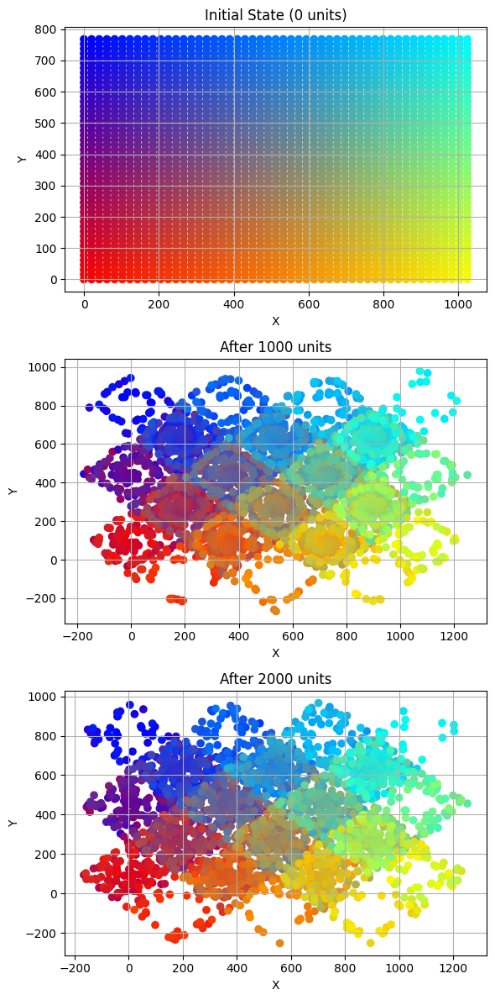

In [12]:
Particle.clear()
Particle.generateGrid(gridX = 50, gridY = 50, width = 4)

# Создаем графики с помощью matplotlib
fig, axes = plt.subplots(3, 1, figsize=(6, 12))

# Первый график: начальное состояние (0 юнитов времени)
Particle.render(axes[0], "Initial State (0 units)")

for i in range(1000): Particle.update()

# Второй график: состояние через 100 юнитов времени
Particle.render(axes[1], "After 1000 units")

for i in range(2000): Particle.update()

# Третий график: состояние через 300 юнитов времени
Particle.render(axes[2], "After 2000 units")


# Отображаем графики
plt.tight_layout()
plt.show()

RuntimeError: Requested MovieWriter (ffmpeg) not available

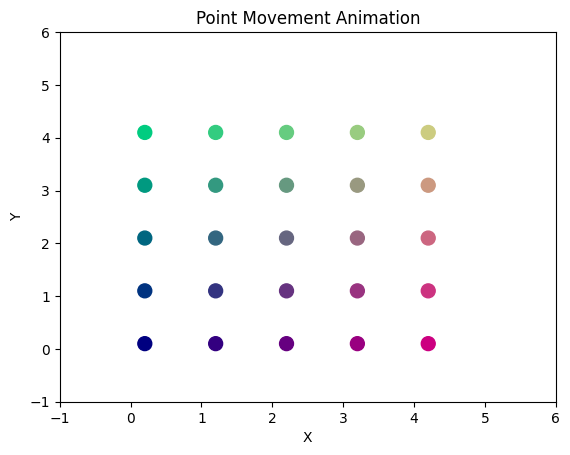

In [21]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Определение класса Point
class Point:
    def __init__(self, x, y, color):
        self.x = x
        self.y = y
        self.color = color

    def update(self):
        # Пример простого правила движения, можно заменить на ваши правила
        self.x += 0.1  # смещаем x
        self.y += 0.05 # смещаем y

    def get_position(self):
        return self.x, self.y

# Создание сетки точек с уникальными цветами
points = []
grid_size = 30  # Определим размер сетки (5x5)
for i in range(grid_size):
    for j in range(grid_size):
        x, y = i, j  # начальные координаты сетки
        color = (i/grid_size, j/grid_size, 0.5)  # задаем уникальный цвет
        points.append(Point(x, y, color))

# Настройка графика
fig, ax = plt.subplots()
ax.set_xlim(-1, grid_size + 1)
ax.set_ylim(-1, grid_size + 1)
ax.set_title("Point Movement Animation")
ax.set_xlabel("X")
ax.set_ylabel("Y")

# Создаем пустой scatter plot, который будем обновлять в анимации
scat = ax.scatter([p.x for p in points], [p.y for p in points], color=[p.color for p in points], s=100)

# Функция для обновления позиций точек на каждом кадре
def update(frame):
    # Обновляем положение каждой точки
    for point in points:
        point.update()

    # Получаем обновленные координаты всех точек
    x_vals = [point.get_position()[0] for point in points]
    y_vals = [point.get_position()[1] for point in points]
    
    # Обновляем данные в scatter plot
    scat.set_offsets(list(zip(x_vals, y_vals)))
    return scat,

# Настройка анимации
anim = FuncAnimation(fig, update, frames=100, interval=1, blit=True)

plt.show()
# from IPython.display import HTML
# HTML(ani.to_jshtml())

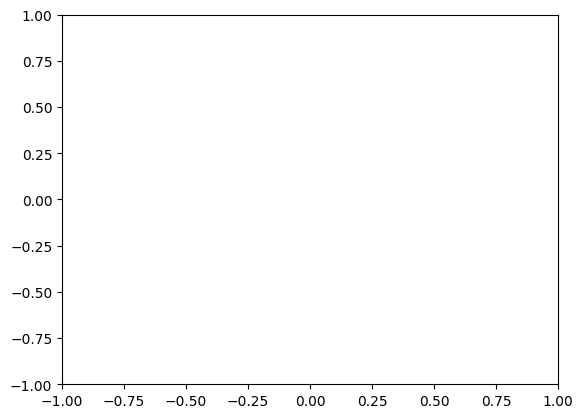

In [11]:
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

t = np.linspace(-2*np.pi,2*np.pi, 200)
x = np.sin(2*t)
y = np.cos(3*t)
fig, ax = plt.subplots()
ax.axis([-1,1,-1,1])
l, = ax.plot([],[])

def animate(i):
    l.set_data(x[:i], y[:i])

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(t))

from IPython.display import HTML
HTML(ani.to_jshtml())

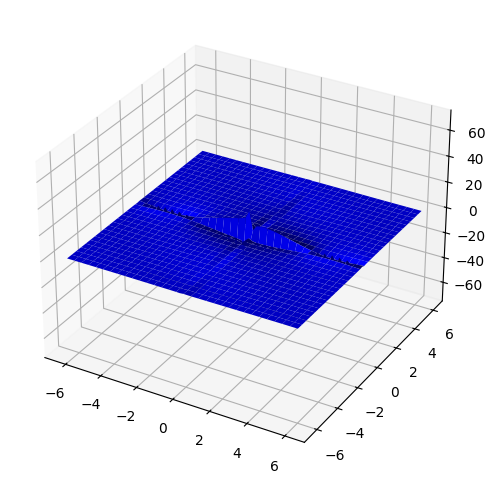

In [16]:
from matplotlib.animation import ArtistAnimation
fig = plt.figure(figsize=(10, 6))
ax_3d = fig.add_subplot(projection='3d')
x = np.arange(-2*np.pi, 2*np.pi, 0.2)
y = np.arange(-2*np.pi, 2*np.pi, 0.2)
xgrid, ygrid = np.meshgrid(x, y)
phasa = np.arange(0, 2*np.pi, 0.1)
frames = []
for p in phasa:
    zgrid = np.sin(xgrid+p) * np.cos(ygrid+p) / (xgrid * ygrid)
 
    line = ax_3d.plot_surface(xgrid, ygrid, zgrid, color='b')
    frames.append([line])
animation = ArtistAnimation(
    fig,                # фигура, где отображается анимация
    frames,              # кадры
    interval=30,        # задержка между кадрами в мс
    blit=True,          # использовать ли двойную буферизацию
    repeat=True)       # зацикливать ли анимацию

from IPython.display import HTML
HTML(animation.to_jshtml())

![1](WhirlpoolScreenShot.png)
![2](WhirlpoolScreenShot2.png)

In [23]:
%matplotlib inline
# Libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
import matplotlib.patches as patches
from IPython.display import HTML

# Necessary Parameters for angular Motion
R = 2
T = 3 # secs
frames = T*25
interval = 40
omega = 2*np.pi/T


def position(time=0):
    x = R*np.cos(omega*time)**3
    y = R*np.sin(omega*time)**3
    return {'x' : x, 'y' : y}

def velocity(time=0,R=0.1):
    x = -R*omega*np.sin(omega*time)**2*3
    y = R*omega*np.cos(omega*time)**2*3
    return {'x' : x, 'y' : y}

def acceleration(time=0,R=0.05):
    x = -R*(omega**2)*np.cos(omega*time)*6
    y = -R*(omega**2)*np.sin(omega*time)*6
    return {'x' : x, 'y' : y}

def init():
    line.set_data([], [])
    theObject.set_data([], [])
    time_text.set_text('')
    return line, theObject, time_text

RuntimeError: x must be a sequence

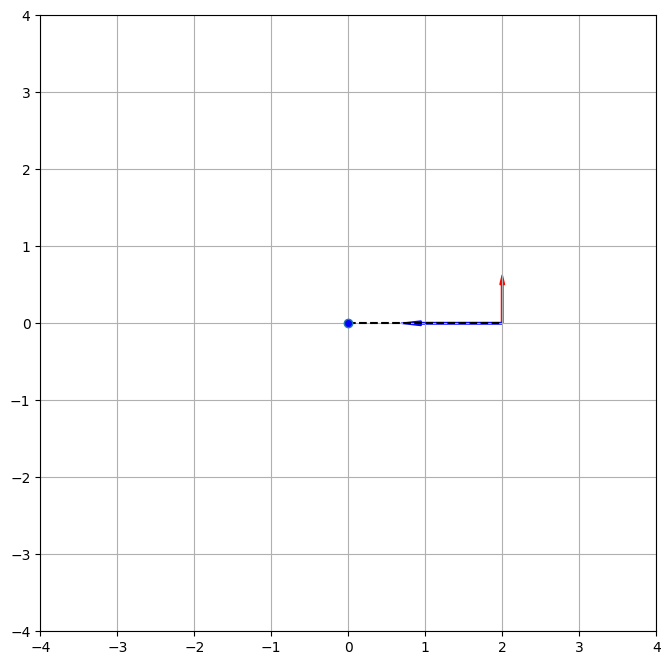

In [24]:
def animate(time):
    time /= (frames/T)
    thisx = [0, position(time)['x'], velocity(time)['x'], acceleration(time)['x']]
    thisy = [0, position(time)['y'], velocity(time)['y'], acceleration(time)['y']]
    line.set_data(thisx[:2], thisy[:2])
    theObject.set_data(thisx[1], thisy[1])
    time_text.set_text(time_template % (time))
    ax.patches.pop(0)
    ax.patches.pop(0)
    velo = ax.add_patch(plt.Arrow(thisx[1],thisy[1],thisx[2],thisy[2], width = 0.1, color = 'r'))
    accel = ax.add_patch(plt.Arrow(thisx[1],thisy[1],thisx[3],thisy[3], width = 0.1, color = 'b'))
    return line, theObject, velo, accel, time_text    


# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(figsize = (8.0,8.0))
ax.set_xlim(( -R*2, R*2))
ax.set_ylim((( -R*2, R*2)))
ax.set_aspect('equal')
ax.grid()
time_template = 'time = %.1fs'
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes, fontsize = 14)  
time_text.set_text(time_template % (0))
line, = ax.plot([0, position(0)['x']], [0, position(0)['y']],'k--')
origin, = ax.plot([0], [0], marker='o', markersize = 6, markerfacecolor = 'b')
theObject, = ax.plot([position(0)['x']], [position(0)['y']], marker = 'o', markersize = 14, markerfacecolor = 'g')
velo = ax.add_patch(plt.Arrow(position(0)['x'], position(0)['y'],  velocity(0)['x'], velocity(0)['y'], width = 0.1, color = 'r'))
accel    = ax.add_patch(plt.Arrow(position(0)['x'], position(0)['y'],  acceleration(0)['x'], acceleration(0)['y'], width = 0.1, color = 'b'))


anim = animation.FuncAnimation(fig, animate, init_func=init, frames = frames, interval = interval, blit=True)
from IPython.display import HTML
HTML(anim.to_jshtml())